# Grotrian Diagrams with dotfit

This notebook shows how to build beautiful **Grotrian diagrams** (energy-level diagrams) using the `GrotrianDiagram` class.

A Grotrian diagram shows:
- **Energy levels** grouped by spectroscopic term
- **Transitions** between levels, colour-coded by wavelength regime (UV / visible / NIR)
- **Line strength** encoded in line width and opacity

The data come from the bundled Kurucz line list (~13,800 Fe II transitions).

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from dotfit import GrotrianDiagram

## 1. Loading the full Fe II dataset

In [2]:
gd = GrotrianDiagram.from_kurucz(ion="Fe II")
print(f"{len(gd.levels)} energy levels, {len(gd.transitions)} transitions")

427 energy levels, 13795 transitions


## 2. A complete Fe II diagram from ground state

Select the key terms that form the backbone of the Fe II level structure: ground-state terms ($a\,^6\!D$, $a\,^6\!S$, ...), intermediate terms ($z\,^6\!P$, ...), and upper levels ($e\,^4\!D$, ...). Use `aggregate=True` to draw one line per term pair.

In [3]:
from pathlib import Path
from astropy.table import Table

terms = [
    "a6D", "a6S", "a4F", "a4D", "a4G", "a4H", "a2D2",
    "b4P", "b4F", "b4D", "b2H", "b4G",
    "z6P", "z6F", "z6D", "z4F", "z4D", "z4P",
    "y4D", "y4G", "y6P", "y4P",
    "x4D",
    "w4F", "c4D", "d4P",
    "e4D", "e6D", "e4F", "f4D",
    # Ly-alpha fluorescence (NIST aliases resolved to Kurucz labels internally)
    "t4G", "u4G", "v4F", "u4D", "u4P",
    "b6D",
]

# Load detected Fe II wavelengths from monster_v5.csv
detected_waves = None
forbidden_waves = None
csv_path = Path("monster_v5.csv")
if csv_path.exists():
    cat = Table.read(csv_path, format="csv")
    ions = [str(r["ion"]).strip() for r in cat]
    fe_mask = [("Fe II" in ion or "Fe III" in ion) for ion in ions]
    detected_waves = list(cat["wave_vac"][fe_mask])
    # Bracket notation [Fe II] = forbidden lines
    forb_mask = [ion.startswith("[Fe") for ion in ions]
    forbidden_waves = list(cat["wave_vac"][forb_mask])
    print(f"Detected Fe II lines: {len(detected_waves)} ({len(forbidden_waves)} forbidden)")

sub = gd.select(terms=terms, gf_min=0.001)
sub.summary()

Detected Fe II lines: 144 (103 forbidden)


term,parity,n_levels,n_transitions,E_min,E_max
str4,str4,int64,int64,float64,float64
4D,odd,18,245,8.953268,12.27539
4G,odd,4,26,11.124772,11.184825
4P,odd,17,280,8.922487,12.164654
6D,odd,20,202,10.379156,11.661678
a2D2,even,2,25,2.543779,2.64186
a4D,even,4,135,0.986331,1.096859
a4F,even,4,113,0.232169,0.386516
a4G,even,4,73,3.152767,3.230461
a4H,even,4,29,2.634864,2.691935


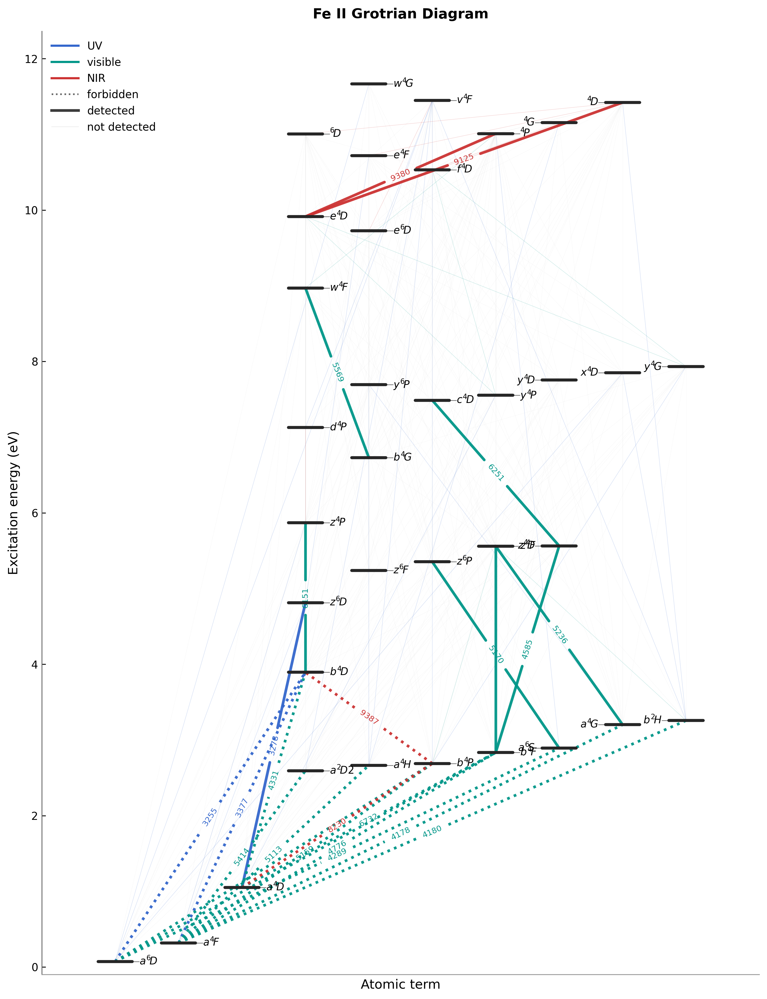

In [4]:
fig = sub.plot(
    layout="compact",
    color_by="wavelength",
    pin_left=["a6D", "a4F", "a4D"],
    aggregate=True,
    figsize=(10, 13),
    min_gap_eV=0.9,
    title="Fe II Grotrian Diagram",
    detected_waves=detected_waves,
    forbidden_waves=forbidden_waves,
)

### Reading the diagram

- **Y-axis**: excitation energy in eV — ground state ($a\,^6\!D$) at the bottom
- **Colours**: blue = UV, teal = visible, red = NIR transitions
- **Thick coloured lines** = detected in the spectrum (matched from `monster_v5.csv`)
- **Faint grey lines** = predicted by Kurucz but not detected
- **Dotted lines** = forbidden transitions (same-parity level pairs)
- **Term labels** next to each bar show the full spectroscopic designation
- `pin_left` places ground-state terms in exclusive leftmost columns to reduce line crossings

## 2a. Sankey-style flow bands

Use `style="sankey"` to render transitions as thick semi-transparent ribbons whose width encodes transition strength (log gf). The same highlighting, colour, and forbidden-line logic applies.

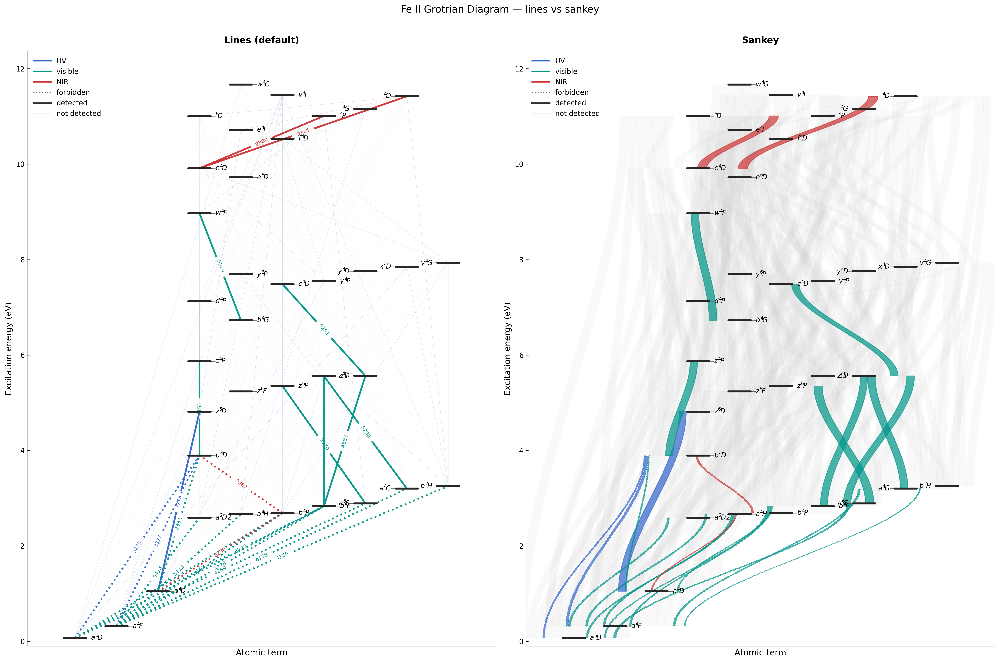

In [5]:
# Same diagram as above, but with Sankey-style flow bands
sub = gd.select(terms=terms, gf_min=0.001)

fig, axes = plt.subplots(1, 2, figsize=(20, 13))

sub.plot(
    ax=axes[0],
    layout="compact",
    color_by="wavelength",
    pin_left=["a6D", "a4F", "a4D"],
    aggregate=True,
    min_gap_eV=0.9,
    title="Lines (default)",
    detected_waves=detected_waves,
    forbidden_waves=forbidden_waves,
)
sub.plot(
    ax=axes[1],
    style="sankey",
    layout="compact",
    color_by="wavelength",
    pin_left=["a6D", "a4F", "a4D"],
    min_gap_eV=0.9,
    title="Sankey",
    detected_waves=detected_waves,
    forbidden_waves=forbidden_waves,
)

fig.suptitle("Fe II Grotrian Diagram — lines vs sankey", fontsize=14, y=1.01)
plt.tight_layout()

## 2b. Highlighting strongest transitions in an energy range

Use `show_strongest_eV` to semi-highlight the strongest permitted transition
from every term in a source energy range to every connected term in a target range.
Pass a list of `((src_lo, src_hi), (tgt_lo, tgt_hi))` tuples — direction is implicit.

For example, `show_strongest_eV=[((4, 6), (0, 2))]` highlights the strongest
permitted line from each z-term (4–6 eV) to each ground-state term (0–2 eV).

Multiple groups can be combined in a single call, e.g.
`[((4, 6), (0, 2)), ((4, 6), (2, 4))]` shows both UV and optical channels.

Parameters:
- `show_strongest_eV`: list of `((src_lo, src_hi), (tgt_lo, tgt_hi))` pairs
- `bg_alpha`: overall opacity of background (non-detected) lines

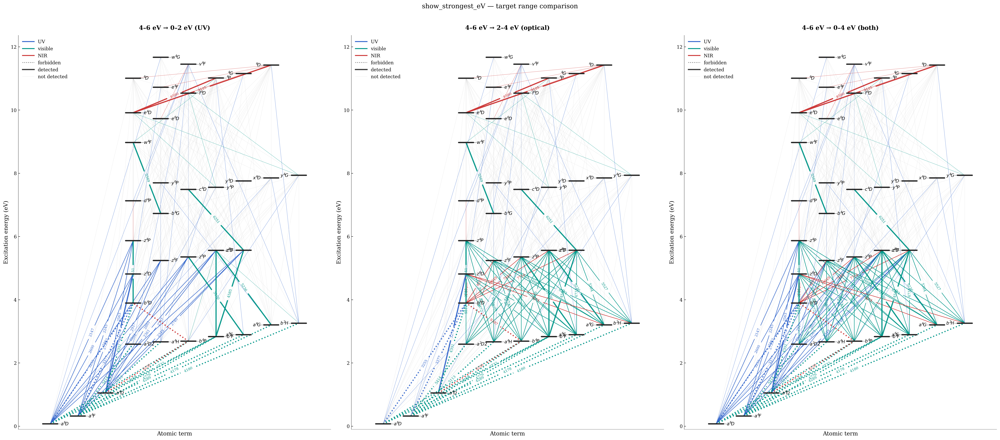

In [ ]:
# Highlight different target ranges from the z-terms (4–6 eV)
sub = gd.select(terms=terms, gf_min=0.001)

fig, axes = plt.subplots(1, 3, figsize=(30, 13))
kw = dict(layout="compact", color_by="wavelength", aggregate=True,
          min_gap_eV=0.9, pin_left=["a6D", "a4F", "a4D"],
          detected_waves=detected_waves, forbidden_waves=forbidden_waves,
          bg_alpha=0.85)

sub.plot(ax=axes[0], show_strongest_eV=[((4, 6), (0, 2))],
         title="4–6 eV → 0–2 eV (UV)", **kw)
sub.plot(ax=axes[1], show_strongest_eV=[((4, 6), (2, 4))],
         title="4–6 eV → 2–4 eV (optical)", **kw)
#sub.plot(ax=axes[2], show_strongest_eV=[((4, 6), (0, 4))],
#         title="4–6 eV → 0–4 eV (both)", **kw)

fig.suptitle("show_strongest_eV — target range comparison", fontsize=14, y=1.01)
plt.tight_layout()

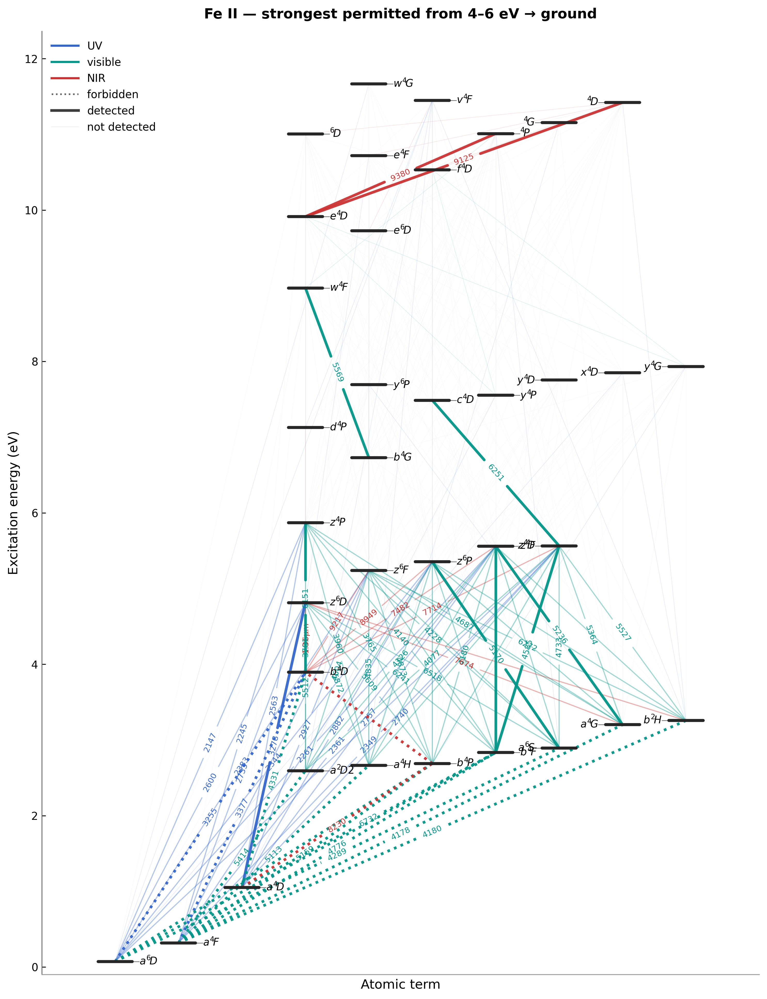

In [7]:
# Single diagram: highlight the z-terms (4–6 eV) with their strongest
# downward transitions.  These are the intermediate odd-parity terms
# (z6P, z6F, z6D, z4F, z4D, z4P) — the gateway between UV absorption
# from ground-state terms and the optical/NIR forbidden cascades.
sub = gd.select(terms=terms, gf_min=0.001)

fig = sub.plot(
    layout="compact",
    color_by="wavelength",
    aggregate=True,
    figsize=(10, 13),
    min_gap_eV=0.9,
    pin_left=["a6D", "a4F", "a4D"],
    title="Fe II — strongest permitted from 4–6 eV → ground",
    detected_waves=detected_waves,
    forbidden_waves=forbidden_waves,
    show_strongest_eV=[((4, 6), (0, 4))],
    bg_alpha=0.15,
)

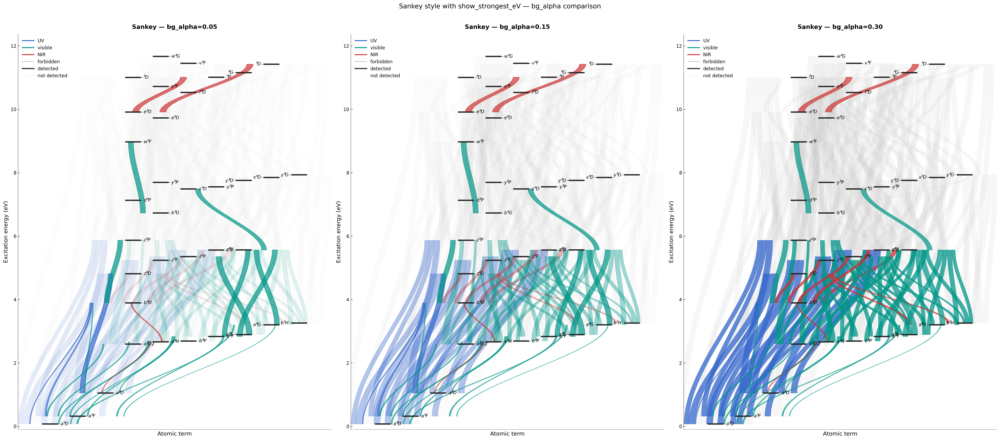

In [8]:
# Same show_strongest_eV diagram in Sankey style — compare bg_alpha values
sub = gd.select(terms=terms, gf_min=0.001)

fig, axes = plt.subplots(1, 3, figsize=(30, 13))
kw = dict(layout="compact", color_by="wavelength", style="sankey",
          min_gap_eV=0.9, pin_left=["a6D", "a4F", "a4D"],
          detected_waves=detected_waves, forbidden_waves=forbidden_waves,
          show_strongest_eV=[((4, 6), (0, 4))])

sub.plot(ax=axes[0], bg_alpha=0.05, title="Sankey — bg_alpha=0.05", **kw)
sub.plot(ax=axes[1], bg_alpha=0.15, title="Sankey — bg_alpha=0.15", **kw)
sub.plot(ax=axes[2], bg_alpha=0.30, title="Sankey — bg_alpha=0.30", **kw)

fig.suptitle("Sankey style with show_strongest_eV — bg_alpha comparison", fontsize=14, y=1.01)
plt.tight_layout()

## 3. Individual vs aggregated transitions

By default, `aggregate=True` draws one line per term pair (cleaner). Set `aggregate=False` to see every individual J-to-J transition.

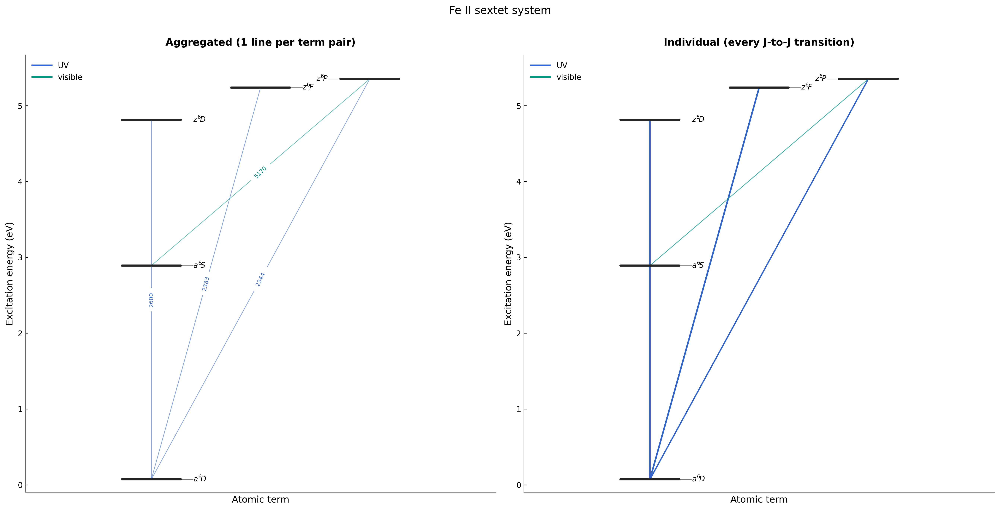

In [9]:
# Fewer terms for a cleaner comparison
sextet = gd.select(
    terms=["a6D", "a6S", "z6P", "z6F", "z6D"],
    gf_min=0.001,
)

fig, axes = plt.subplots(1, 2, figsize=(18, 9))

sextet.plot(ax=axes[0], aggregate=True, title="Aggregated (1 line per term pair)")
sextet.plot(ax=axes[1], aggregate=False, title="Individual (every J-to-J transition)")

fig.suptitle("Fe II sextet system", fontsize=14, y=1.01)
plt.tight_layout()

## 4. Using wavelength presets

Built-in presets (`"uv"`, `"optical"`, `"nir"`) filter by wavelength range and auto-select the most transition-rich terms.

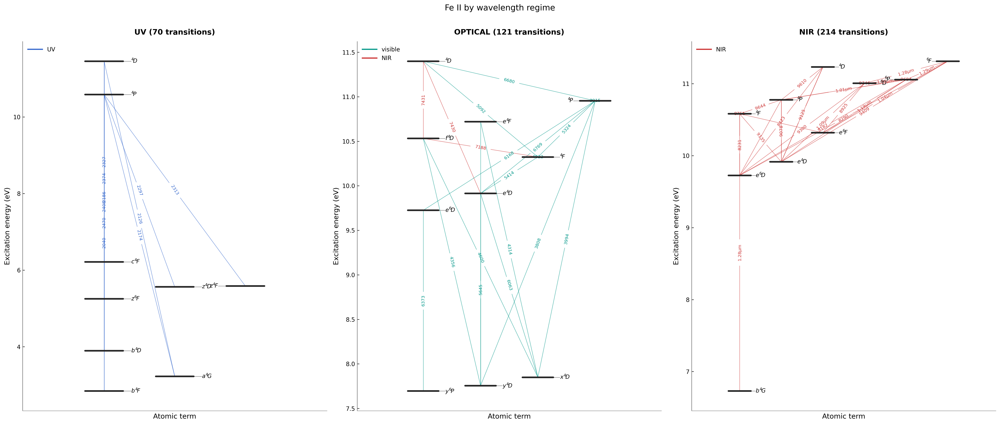

In [10]:
fig, axes = plt.subplots(1, 3, figsize=(24, 10))

for ax, preset in zip(axes, ["uv", "optical", "nir"]):
    sub = gd.select(preset=preset, gf_min=0.001, max_terms=10)
    sub.plot(ax=ax, aggregate=True, title=f"{preset.upper()} ({len(sub.transitions)} transitions)")

fig.suptitle("Fe II by wavelength regime", fontsize=14, y=1.01)
plt.tight_layout()

## 5. Selecting specific terms

Pass an explicit list of terms for a focused diagram.

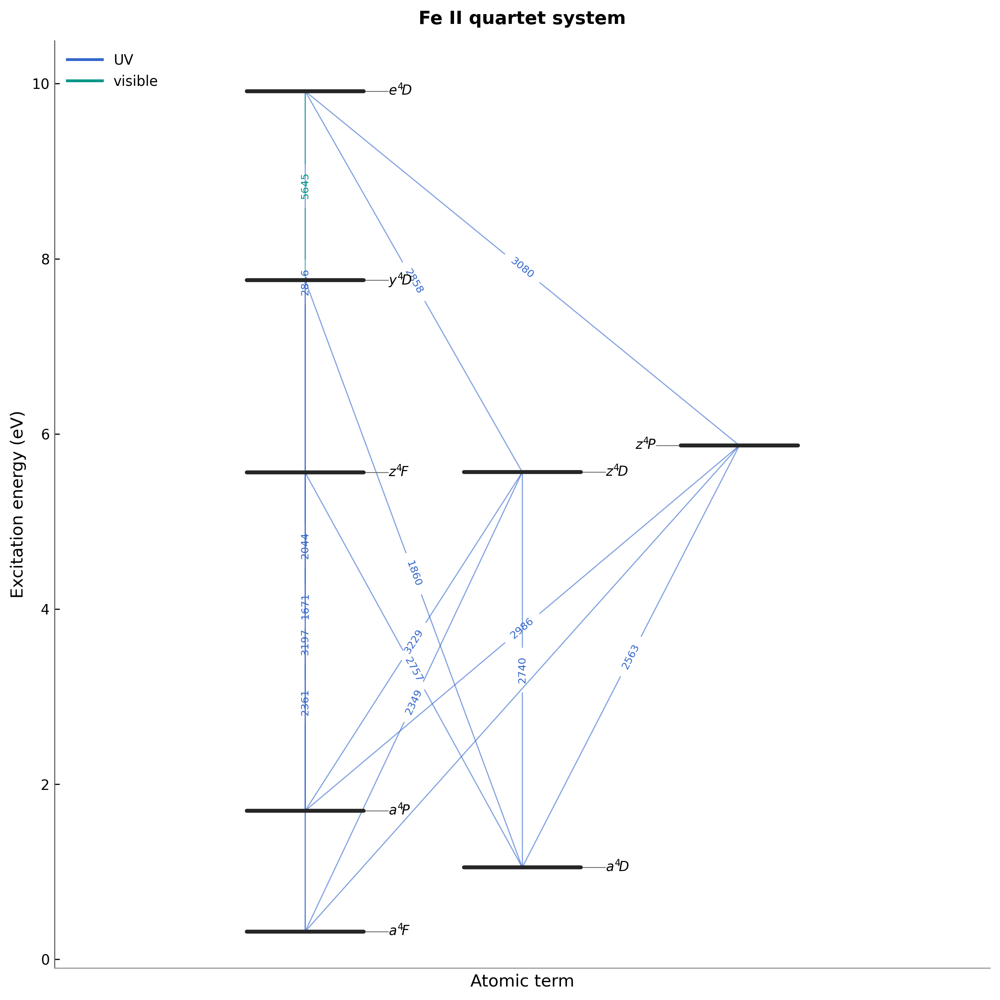

In [11]:
quartet = gd.select(
    terms=["a4F", "a4D", "a4P", "z4F", "z4D", "z4P", "e4D", "y4D"],
    gf_min=0.001,
)

fig = quartet.plot(
    aggregate=True,
    title="Fe II quartet system",
    figsize=(10, 10),
)

## 6. Classification-based colouring

Use `color_by="classification"` to colour by permitted (blue) vs forbidden (grey dotted) instead of by wavelength.

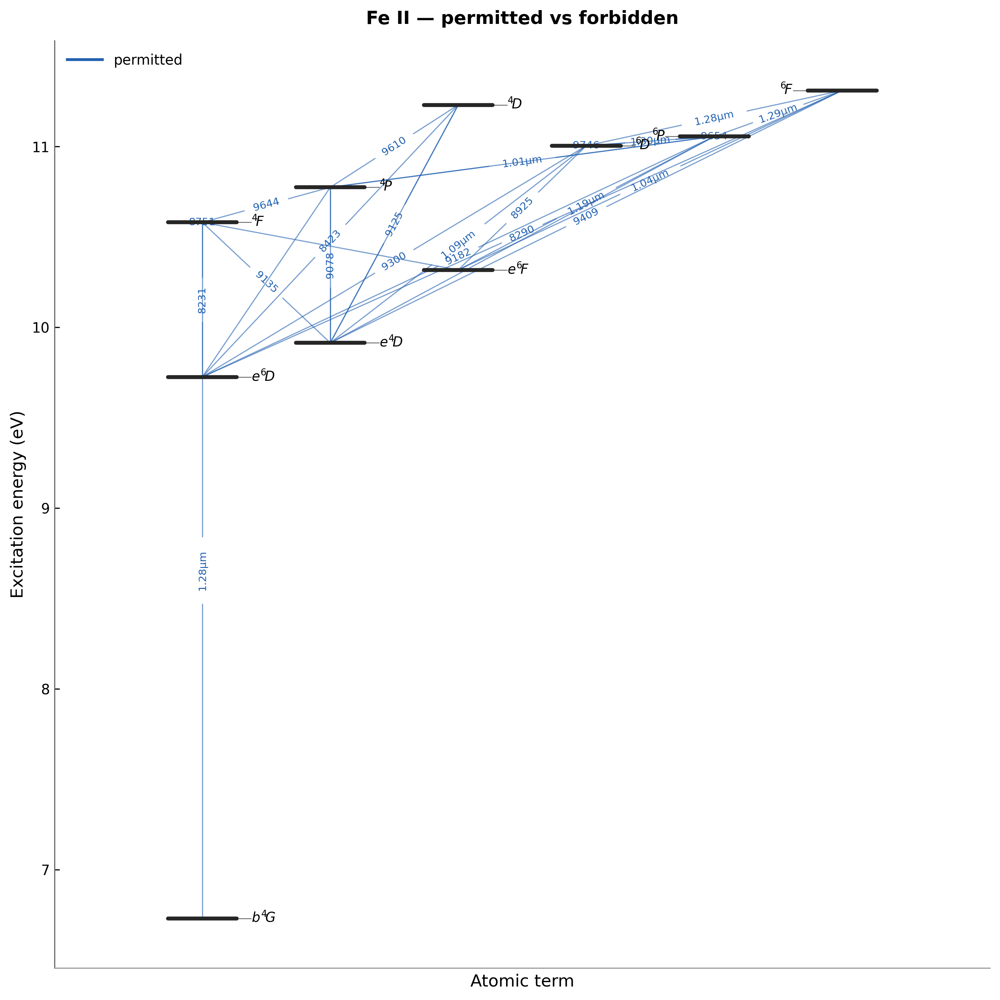

In [12]:
fig = sub.plot(
    color_by="classification",
    aggregate=True,
    title="Fe II — permitted vs forbidden",
    figsize=(10, 10),
)

## 7. Parity-separated columns layout

The `layout="columns"` mode groups terms into strict even/odd parity columns with individual J sub-levels visible.

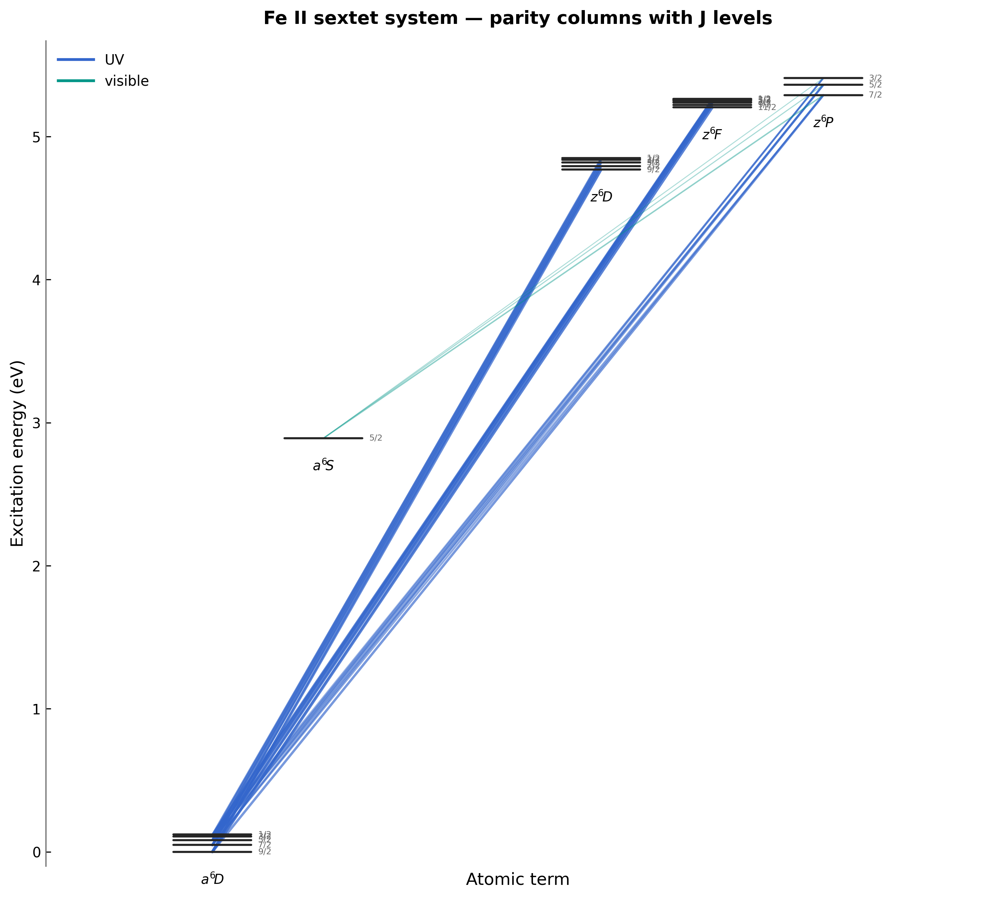

In [13]:
sextet = gd.select(
    terms=["a6D", "a6S", "z6P", "z6F", "z6D"],
    gf_min=0.001,
)

fig = sextet.plot(
    layout="columns",
    show_j=True,
    aggregate=False,
    figsize=(10, 9),
    title="Fe II sextet system — parity columns with J levels",
)

## 8. Filtering by oscillator strength

Higher `gf_min` shows only the strongest transitions — cleaner for publication.

Requested terms not found in data: ['b4G', 'c4D', 'd4P']. Available terms: ['2D', '2F', '2G', '2H', '2P', '2S', '4D', '4F', '4G', '4P', '4S', '6D', '6F', '6P', '6S', 'a2D2', 'a2F', 'a2G', 'a2H', 'a2I', 'a2P', 'a2S', 'a4D', 'a4F', 'a4G', 'a4H', 'a4P', 'a6D', 'a6S', 'b2D', 'b2F', 'b2G', 'b2H', 'b2P', 'b4D', 'b4F', 'b4P', 'c2D', 'c2F', 'c2G', 'c2P', 'c4F', 'c4P', 'd2D1', 'd2F', 'd2G', 'e2H', 'e4D', 'e4F', 'e4G', 'e4H', 'e6D', 'e6F', 'e6G', 'f4D', 'f4F', 't2F', 'u2D', 'u2F', 'u2G', 'u4F', 'v2D', 'v2F', 'v2G', 'v2H', 'v4D', 'v4F', 'w2D', 'w2F', 'w2G', 'w2H', 'w2P', 'w4D', 'w4F', 'w4G', 'w6P', 'x2D', 'x2G', 'x2H', 'x2P', 'x4D', 'x4F', 'x4G', 'x4H', 'x4P', 'x6P', 'y2D', 'y2F', 'y2G', 'y2H', 'y2I', 'y2P', 'y4D', 'y4F', 'y4G', 'y4H', 'y4P', 'y6F', 'y6P', 'z2D', 'z2F', 'z2G', 'z2H', 'z2I', 'z2K', 'z2P', 'z2S', 'z4D', 'z4F', 'z4G', 'z4H', 'z4I', 'z4P', 'z4S', 'z6D', 'z6F', 'z6P']


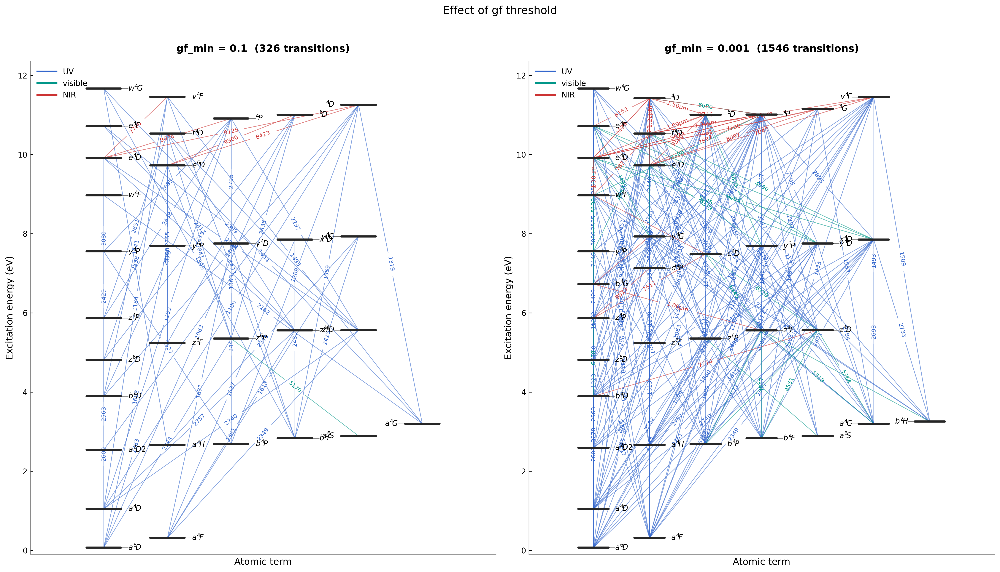

In [14]:
fig, axes = plt.subplots(1, 2, figsize=(18, 10))

for ax, gf_min in zip(axes, [0.1, 0.001]):
    sub = gd.select(terms=terms, gf_min=gf_min)
    sub.plot(ax=ax, aggregate=True,
             title=f"gf_min = {gf_min}  ({len(sub.transitions)} transitions)")

fig.suptitle("Effect of gf threshold", fontsize=14, y=1.02)
plt.tight_layout()

## 9. Semi-forbidden lines only

Filter to just the intercombination (Fe II]) lines seen in AGN / LRD spectra.

Semi-forbidden: 129 transitions


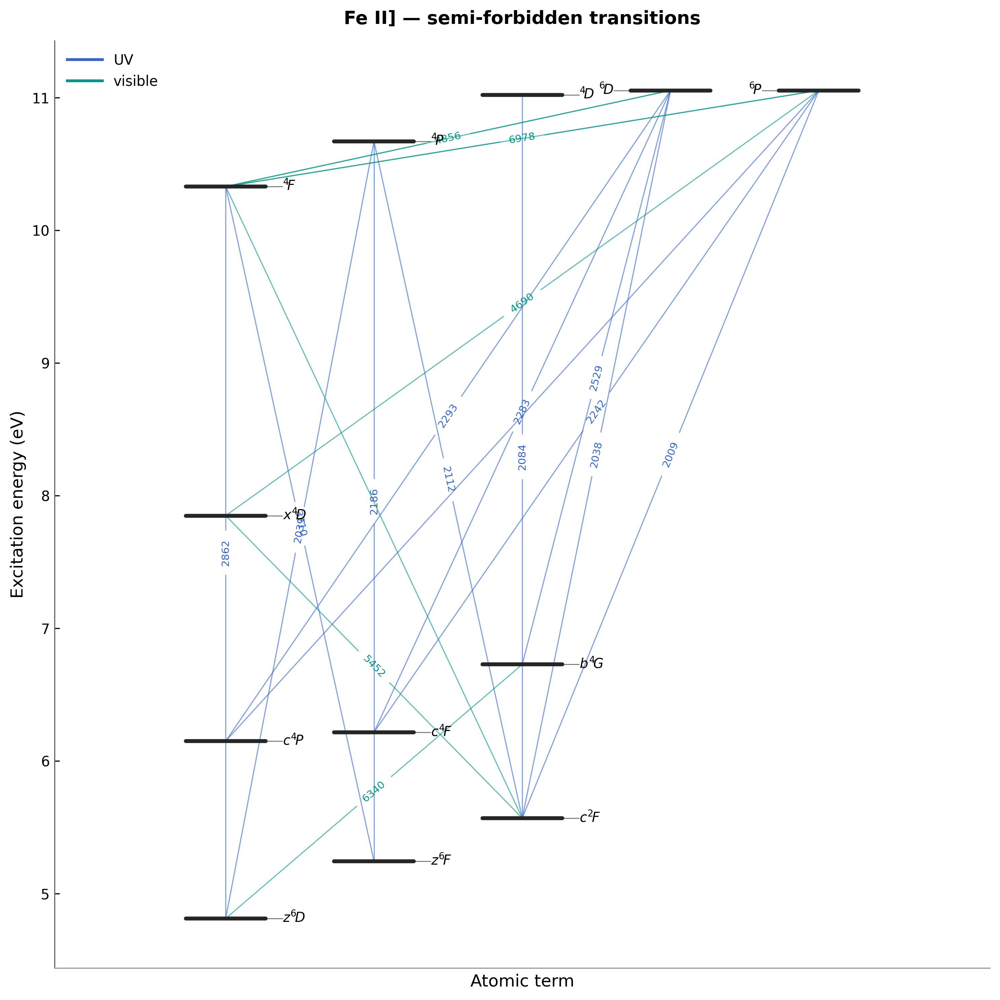

In [15]:
sf = gd.select(
    wave_range=(2000, 7000),
    classification="semi-forbidden",
    gf_min=1e-5,
    max_terms=12,
)
print(f"Semi-forbidden: {len(sf.transitions)} transitions")

fig = sf.plot(
    aggregate=True,
    title="Fe II] — semi-forbidden transitions",
    figsize=(10, 10),
)

## 10. Custom wavelength range

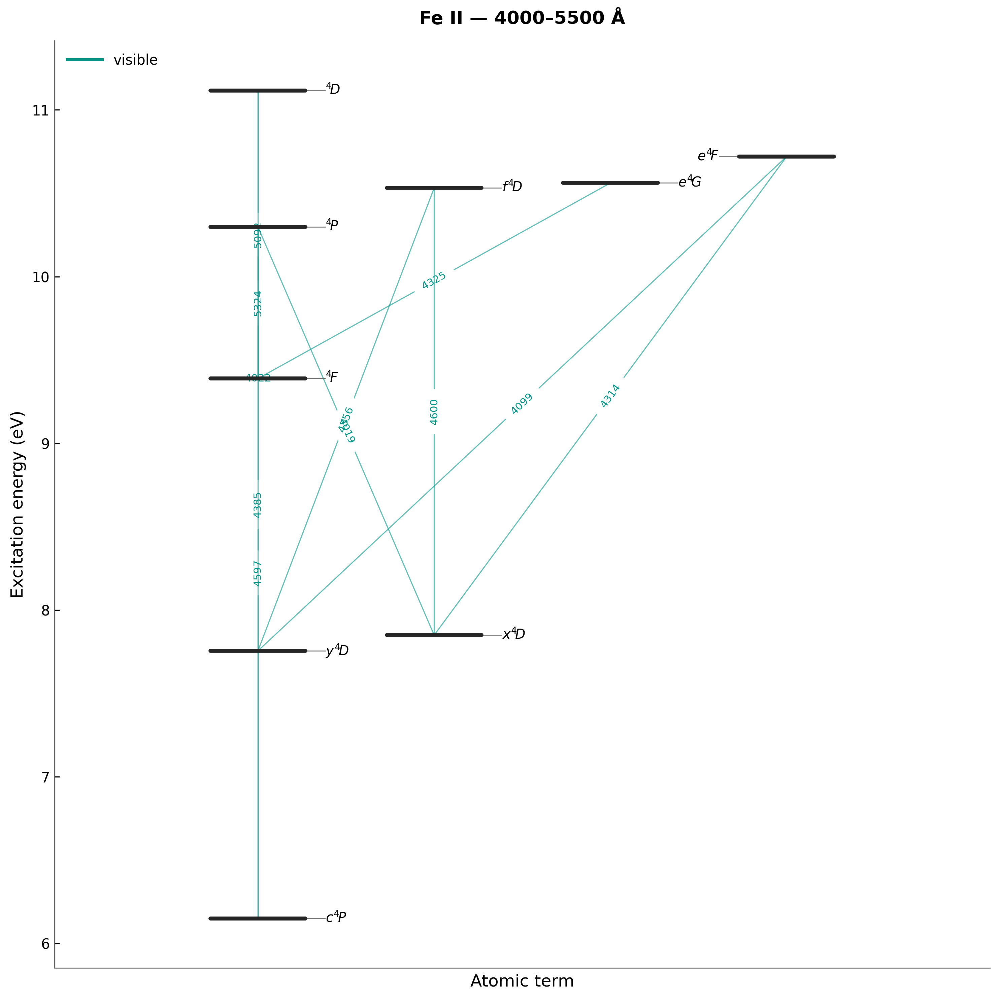

In [16]:
custom = gd.select(wave_range=(4000, 5500), gf_min=0.001, max_terms=10)

fig = custom.plot(
    aggregate=True,
    title="Fe II — 4000–5500 Å",
    figsize=(10, 10),
)

## 11. Other ions

The Kurucz table also contains Fe I and Ti I/II lines.

Ions: ['Fe I', 'Fe II', 'Ti I', 'Ti II']
Fe I: 648 levels, 21145 transitions


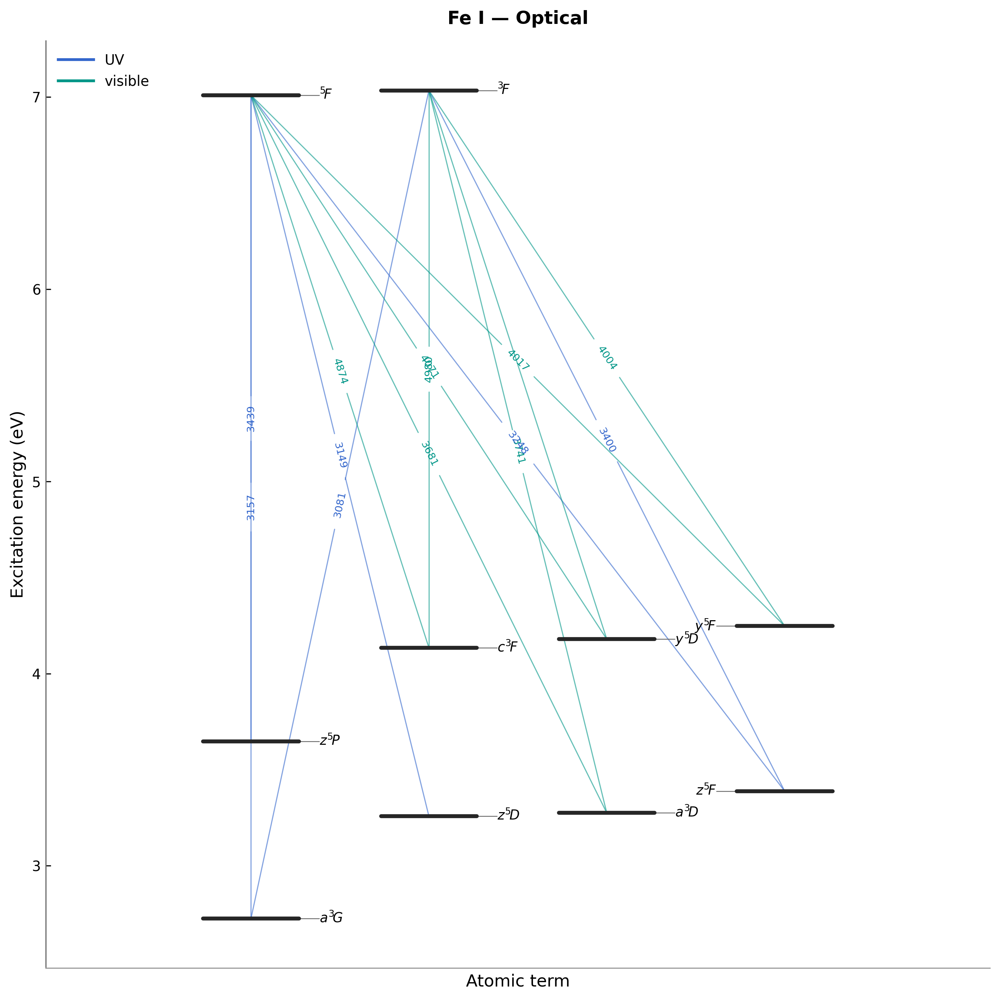

In [17]:
from astropy.table import Table

tab = Table.read("../dotfit/data/emission_lines/feti_kurucz.csv", format="csv")
print(f"Ions: {sorted(set(tab['ion']))}")

fe1 = GrotrianDiagram.from_table(tab, ion="Fe I")
print(f"Fe I: {len(fe1.levels)} levels, {len(fe1.transitions)} transitions")

if fe1.transitions:
    sub = fe1.select(wave_range=(3000, 7000), gf_min=0.01, max_terms=10)
    fig = sub.plot(aggregate=True, title="Fe I — Optical", figsize=(10, 10))

## Tips for publication-quality figures

- Use `gf_min >= 0.01` for clean, uncluttered diagrams
- Select 15–25 terms with explicit `terms=[]` for curated diagrams
- Use `aggregate=True` (default) for one line per term pair
- Use `color_by="wavelength"` for wavelength-regime colouring
- Adjust `min_gap_eV` to control vertical spacing between terms
- Save with `bbox_inches="tight"` to avoid clipping labels
- For multi-panel figures, pass `ax=` to embed in subplots

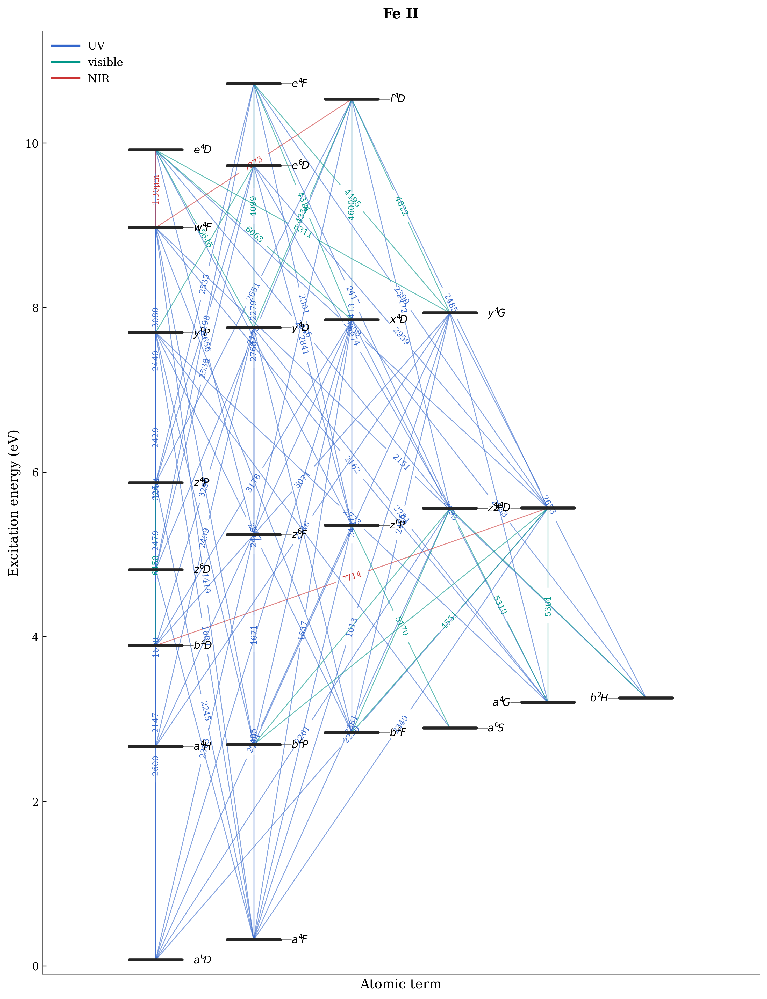

In [18]:
# Publication-ready example
plt.rcParams.update({
    "font.family": "serif",
    "font.size": 11,
    "axes.linewidth": 0.8,
})

terms_pub = [
    "a6D", "a6S", "a4F", "a4G", "a4H",
    "b4P", "b4F", "b4D", "b2H",
    "z6P", "z6F", "z6D", "z4F", "z4D", "z4P",
    "y4D", "y4G", "y6P",
    "x4D", "w4F",
    "e4D", "e6D", "e4F", "f4D",
]

sub = gd.select(terms=terms_pub, gf_min=0.001)
fig = sub.plot(
    aggregate=True,
    figsize=(10, 13),
    min_gap_eV=0.9,
    title="Fe II",
)
# fig.savefig("grotrian_feii.pdf", bbox_inches="tight")